In [2]:
#import necessary libraries
import torch
import string
import numpy as np 
import pandas as pd 
import tensorflow as tf
from sklearn import preprocessing 
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from transformers import BertTokenizer, BertModel
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import silhouette_score
import plotly.graph_objects as go
import numpy as np
from plotly.offline import init_notebook_mode, iplot
from sklearn.cluster import AgglomerativeClustering

In [ ]:
#read dataframe and store in local variable df
df = pd.read_csv('/kaggle/input/youtube-videos-and-the-comments/YT_Videos_Comments.csv')
df = df.sample(frac=1).reset_index(drop = True)

In [ ]:
df.head()

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 861962 entries, 0 to 861961
Data columns (total 9 columns):
 #   Column                     Non-Null Count   Dtype 
---  ------                     --------------   ----- 
 0   User                       861962 non-null  object
 1   Video Title                861813 non-null  object
 2   Video Description          665195 non-null  object
 3   Video ID                   432632 non-null  object
 4   Comment (Displayed)        394587 non-null  object
 5   Comment (Actual)           379081 non-null  object
 6   Comment Author             379053 non-null  object
 7   Comment Author Channel ID  379094 non-null  object
 8   Comment Time               379100 non-null  object
dtypes: object(9)
memory usage: 59.2+ MB


In [6]:
#copy the dataframe 
new = df.copy()

#drop rows where actual comments are missing
new = new.dropna(subset=['Comment (Actual)'])

#drop unnecessary columns
new = new.drop(columns = ['Video Description','Video ID','Comment (Displayed)','Comment Author','Comment Author Channel ID','Comment Time'], axis=0)

In [7]:
# label_encoder object 
label_encoder = preprocessing.LabelEncoder()
  
# Encode labels in column 'species'.
new['User'] = label_encoder.fit_transform(new['User'])
new['Video Title'] = label_encoder.fit_transform(new['Video Title'])


In [8]:
#new dataframe with categorical 'User' and 'Video Title' columns
new = new.reset_index(drop = True)
new.head()

,User,Video Title,Comment (Actual)
0,2,256,Love that outro joke 😹😹😹
1,2,119,how energie efficient are the fuelcells compar...
2,2,13,Soooo the frozen tundra thawing and becoming f...
3,3,122,India is waste corrupt hey India government fi...
4,2,52,"🙏💕 Dear Lord, Please protect and heal our prec..."


In [9]:
new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 379081 entries, 0 to 379080
Data columns (total 3 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   User              379081 non-null  int64 
 1   Video Title       379081 non-null  int64 
 2   Comment (Actual)  379081 non-null  object
dtypes: int64(2), object(1)
memory usage: 8.7+ MB


In [10]:
# Define a function to clean the text
def clean_text(text):
    # Remove punctuation marks
    text = text.translate(str.maketrans("", "", string.punctuation))

    # Remove emojis
    text = text.encode('ascii', 'ignore').decode('ascii')

    # Convert all capital letters to lowercase
    text = text.lower()

    # Tokenize the text
    tokens = word_tokenize(text)

    # Remove stopwords    
    stopwords_set = set(stopwords.words('english'))
    clean_tokens = [token for token in tokens if token not in stopwords_set]

    # Join the tokens back into a single string and return it
    clean_txt = ' '.join(clean_tokens)
    return clean_txt


In [ ]:
# Clean the comments 
for i in range(len(new['Comment (Actual)'])):
    new['Comment (Actual)'][i] = clean_text(new.iloc[i]['Comment (Actual)'])

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load BERT tokenizer and model
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased').to(device)

# Define function to encode text using BERT
def encode_text(text):
    
    # Tokenize text
    tokens = tokenizer.encode(text, truncation=True, max_length=512, add_special_tokens=True)
    
    # Convert tokens to PyTorch tensor
    input_ids = torch.tensor([tokens]).to(device)
    
    # Get BERT model output
    with torch.no_grad():
        outputs = model(input_ids)
        
    # Extract last hidden state
    last_hidden_state = outputs[0][:, 0, :].cpu().numpy()
    return last_hidden_state

In [13]:
length = len(new['Comment (Actual)'])
embeddings = [encode_text(new.iloc[i]['Comment (Actual)']) for i in range(length)]

In [14]:
#output_tensors1 is the reshape array consisting of all tensors
output_tensors1 = np.squeeze(np.array(embeddings), axis=1)
output_tensors1.shape

(379081, 768)

In [15]:
# Create comments array
comments = []
for i in range(length):
    
    # Define the tensor
    tensor = [output_tensors1[i]]
    
    # Compute the SVD of the tensor
    s,u,v = tf.linalg.svd(tensor, full_matrices=False, compute_uv=True, name=None)
    
    # Extract the singular value and convert it to a scalar
    singular_value = s.numpy()[0]
    
    # Append the singular value to comments array
    comments.append(singular_value)

In [16]:
#create a new DataFrame
X = pd.DataFrame()

#copy the user and video title columns
X['User'] = new.iloc[0:length:1]['User']
X['Video Title'] = new.iloc[0:length:1]['Video Title']

#comments column consists of SVD values of tensors that represented comments
X['Comments'] = comments
X

,User,Video Title,Comments
0,2,256,14.344137
1,2,119,13.591874
2,2,13,13.343178
3,3,122,14.127850
4,2,52,14.542435
...,...,...,...
379076,2,11,13.601476
379077,3,243,14.323075
379078,2,248,13.509952
379079,0,142,14.039787


In [17]:
#initialize PCA object
pca = PCA(n_components = 3)

#apply pca on data
X_pca = pca.fit_transform(X)

#saved in a new variable X_pca
X_pca = pd.DataFrame(X_pca)

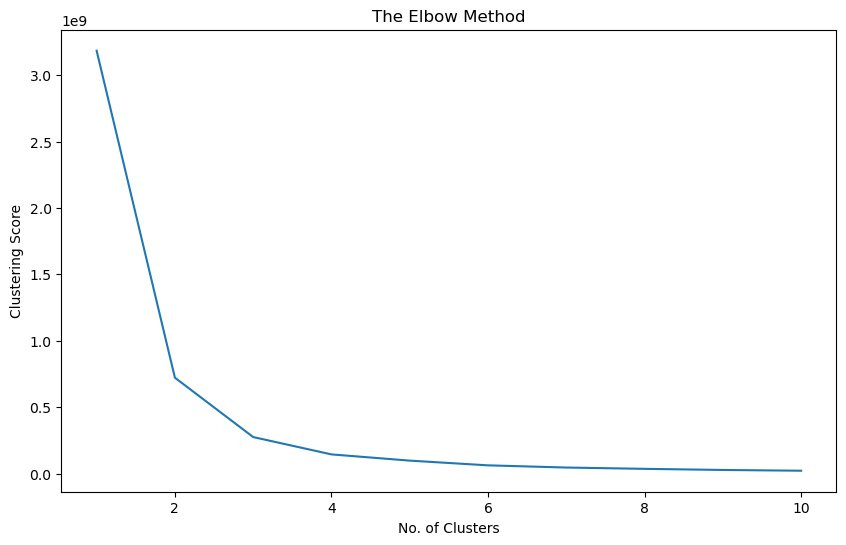

In [18]:
# Array to store clustering score
clustering_score = []

for i in range(1, 11):
    
    # Perform clustering for different number of clusters
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(X_pca)
    
    # inertia_ = Sum of squared distances of samples to their closest cluster center.
    clustering_score.append(kmeans.inertia_) 
    
# Plot the graph
plt.figure(figsize=(10,6))
plt.plot(range(1, 11), clustering_score)
plt.title('The Elbow Method')
plt.xlabel('No. of Clusters')
plt.ylabel('Clustering Score')
plt.show()

In [19]:
# Initialize k-means with k=2
kmeans = KMeans(n_clusters = 2, init = 'k-means++', random_state = 42)

# Fit the model to the data
kmeans.fit(X_pca)

# Get the SSE score
SSE = kmeans.inertia_

# Get the silhouette score
silhouette_avg = silhouette_score(X_pca, kmeans.labels_)

# Print the results
print("SSE:", SSE)
print("Silhouette Score:", silhouette_avg)


SSE: 722195468.8088534
Silhouette Score: 0.6555125545924034


In [20]:
# Predict the labels
y_kmeans = kmeans.fit_predict(X_pca)

# Add labels column to X_pca dataframe
X_pca['labels'] = y_kmeans

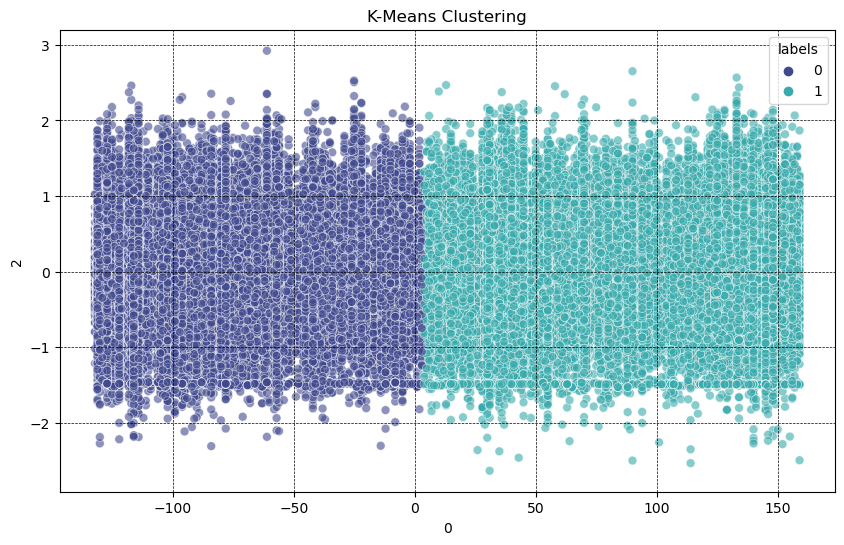

In [21]:
# Plot the cluster using sns
plt.figure(figsize=(10,6))
sns.scatterplot(data = X_pca, x = 0, y = 2, hue = 'labels', legend = "full", palette = "mako",s = 40, alpha = 0.6)
plt.grid(color='black', linestyle='--', linewidth=0.5)
plt.title('K-Means Clustering')
plt.show()

In [42]:
init_notebook_mode(connected=True)

# Define color map
colormap = np.array(['#ff7f0e', '#1f77b4'])

# Create trace for scatterplot
trace = go.Scatter3d(
    x=X_pca.iloc[:, 0],
    y=X_pca.iloc[:, 1],
    z=X_pca.iloc[:, 2],
    mode='markers',
    marker=dict(
        size=5,
        color = y_kmeans,
        opacity=0.8
    )
)

# Create layout
layout = go.Layout(
    scene=dict(
        xaxis=dict(title='X Axis'),
        yaxis=dict(title='Y Axis'),
        zaxis=dict(title='Z Axis')
    )
)

# Create figure
fig = go.Figure(data=[trace], layout=layout)

# Show figure
iplot(fig)

In [30]:
new['labels'] = y_kmeans
new

,User,Video Title,Comment (Actual),labels
0,2,256,love outro joke,0
1,2,119,energie efficient fuelcells compared batterie ...,1
2,2,13,soooo frozen tundra thawing becoming fertile l...,1
3,3,122,india waste corrupt hey india government first...,1
4,2,52,dear lord please protect heal precious dianna ...,1
...,...,...,...,...
379076,2,11,boulder rock pioneers use ride babies miles,1
379077,3,243,waffle house found new host,0
379078,2,248,sending one fish tanks thought super rare thing,0
379079,0,142,unique way editing background music thats main...,1


In [31]:
def get_percentage(label):
    c = np.count_nonzero(new['labels'] == label)
    p = (c/length)*100
    return p
print("The percentage of class 0 in K-Means Clustering is",get_percentage(0))
print("The percentage of class 1 in K-Means Clustering is",get_percentage(1))

The percentage of class 0 in K-Means Clustering is 51.83430454177339
The percentage of class 1 in K-Means Clustering is 48.1656954582266


In [ ]:
#Agglomerative/ Hierarchical Clustering 
clustering = AgglomerativeClustering(n_clusters = 2).fit(np.array(X_pca.head(10000)))

In [ ]:
# Plot the cluster using sns
plt.figure(figsize=(10,6))
sns.scatterplot(data = X_pca.head(10000), x = 0, y = 2, hue = clustering.labels_, legend = "full", palette = "rocket",s = 40, alpha = 0.6)
plt.grid(color='black', linestyle='--', linewidth=0.5)
plt.title('Agglomerative Clustering')
plt.show()